# Setup environment


*   Locate the files
*   Install / import necessary packages



In [ ]:
!pip install pyquery
!sudo apt-get install graphviz libgraphviz-dev pkg-config
!pip3 install pygraphviz
!pip3 install pyvis

Reading package lists... Done
Building dependency tree       
Reading state information... Done
pkg-config is already the newest version (0.29.1-0ubuntu2).
graphviz is already the newest version (2.40.1-2).
The following additional packages will be installed:
  libgail-common libgail18 libgtk2.0-0 libgtk2.0-bin libgtk2.0-common
  libgvc6-plugins-gtk libxdot4
Suggested packages:
  gvfs
The following NEW packages will be installed:
  libgail-common libgail18 libgraphviz-dev libgtk2.0-0 libgtk2.0-bin
  libgtk2.0-common libgvc6-plugins-gtk libxdot4
0 upgraded, 8 newly installed, 0 to remove and 30 not upgraded.
Need to get 2,120 kB of archives.
After this operation, 7,128 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/main amd64 libgtk2.0-common all 2.24.32-1ubuntu1 [125 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/main amd64 libgtk2.0-0 amd64 2.24.32-1ubuntu1 [1,769 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/main amd64 libgail18 amd64 2

In [ ]:
from xml.dom import minidom
from pyquery import PyQuery
from networkx.readwrite import json_graph
from collections import Counter
import os, json, math, collections, itertools, random, pickle
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib as mpl
import matplotlib.pyplot as plt
import statistics as stats

from pyvis.network import Network

import copy

# Data preparation

*   From a given json file, GetResultIndex.json



In [ ]:
'''
In this cell, we generate 2 lists, dictItems and dictTypes.
dictItems contains all items in json file
dictTypes contains all types in json file
'''

with open(os.path.join(os.getcwd(),"data_gt","GetResultIndex.json")) as json_file:
  json_Ref = json.load(json_file);  print(type(json_Ref)); #print(json_Ref.items())

for key,val in json_Ref.items():
  print(key, "total:", len(val), type(val));
  if key == "items":    dictItems=val
  else: dictTypes=val
print("\n")

print("dictItems contains:",len(dictItems),type(dictItems))
i=0
for i in range(len(dictItems)):
  if i<10:    print(dictItems[i])

print("\n")
i=0
print("dictTypes contains:",len(dictTypes),type(dictTypes))
for i in range(len(dictTypes)):
  if i<10:    print(dictTypes[i])

<class 'dict'>
items total: 10591 <class 'list'>
types total: 2041 <class 'list'>


dictItems contains: 10591 <class 'list'>
{'itemId': 'ABCapacityLimits Index[District,TaskType]', 'identities': [{'id': 'ABCapacityLimits Index[District,TaskType]', 'type': 'ABCapacityLimits Index', 'fields': {'IdName': 'District,TaskType'}}], 'ownerItem': 'Collection[ABCapacityLimits]', 'dependencies': ['ABCapacityLimits Property[District]', 'ABCapacityLimits Property[TaskType]']}
{'itemId': 'ABCapacityLimits Index[Key]', 'identities': [{'id': 'ABCapacityLimits Index[Key]', 'type': 'ABCapacityLimits Index', 'fields': {'IdName': 'Key'}}], 'ownerItem': 'Collection[ABCapacityLimits]', 'dependencies': ['ABCapacityLimits Property[Key]']}
{'itemId': 'ABCapacityLimits Index[Name]', 'identities': [{'id': 'ABCapacityLimits Index[Name]', 'type': 'ABCapacityLimits Index', 'fields': {'IdName': 'Name'}}], 'ownerItem': 'Collection[ABCapacityLimits]', 'dependencies': ['ABCapacityLimits Property[Name]']}
{'itemId': 'AB

## Explore Items

In [ ]:
# Show items with multiple identities ---------------------------------

print("Total all items:",len(dictItems), "items")
count= 0
for i in range(len(dictItems)):
  if len(dictItems[i]["identities"]) > 1:
    count+=1
print("Total items with multiple identies:", count, "items")

Total all items: 10591 items
Total items with multiple identies: 615 items


In [ ]:
## An example of requesting a single item based on itemId ---------------------

aItem = next(item for item in dictItems if item["itemId"] == "Group Property[Key]")
aItem

{'dependencies': ['Collection[Group]', 'Group Property[Name]'],
 'identities': [{'fields': {'IdName': 'Key'},
   'id': 'Group Property[Key]',
   'type': 'Group Property'}],
 'itemId': 'Group Property[Key]',
 'ownerItem': 'Collection[Group]'}

In [ ]:
'''
listAKA_multi will be a list of all items that have multiple id. 
The items with multiple ids will be put together in a list.
Hence, listAKA_multi is a 'list of list' of the multiple items. 
'''
listAKA_multi = []
k=0

for i in dictItems:
  if len(i['identities']) >1:
    tmpAKA = [i['itemId']]
    for j in i['identities']:
      if j['id'] not in tmpAKA:
        tmpAKA.append(j['id'])
    #print("-"*50)
    k+=1
    listAKA_multi.append(tmpAKA)
print("Total items with multiple ids:", len(listAKA_multi), listAKA_multi)

# Here, we check if there is an overlap item in listAKA
# So far there is no overlap.
for i in range(len(listAKA_multi)):
  #print(i)
  checkList = listAKA_multi[i]
  remainList = [listAKA_multi[x] for x in range(len(listAKA_multi)) if x!=i]
  #print(len(remainList), len(listAKA_multi))
  for j in checkList:
    for k in remainList:
      if j in k: print("found overlap ")
  #print("-"*50)

# ==============================================================================
'''
listAKA_single will be a list of all items that have single id only.
Similar with the listAKA_multi, listAKA_single is a 'list of list' of the single items. 
'''
def check_item_in_listAKA(itemId, listAKA):
  # check if an item in both listAKA_multi and listAKA_multi. So far, there is no duplication (return 0)
  for i in listAKA:
    if itemId in i:
      return 1
  return 0

k= 0
listAKA_single = [] 
for i in dictItems:
  if len(i['identities']) <= 1:
    #print("itemId:",i['itemId'])
    ch = check_item_in_listAKA(i['itemId'], listAKA_multi)
    if ch == 0:
      if i['itemId'] not in listAKA_single: listAKA_single.append([i['itemId']])
    else: print("dup")
    #print("-"*50)
    k+=1
print("Total items with single id:", len(listAKA_single), listAKA_single)

# ==============================================================================
listAKA = listAKA_single + listAKA_multi
print("Total all items:",len(listAKA), listAKA)

Total items with multiple ids: 615 [['Objective[_Eval - Delay after Appointment Start]', 'TimeCostBVF[_Eval - Delay after Appointment Start]'], ['Objective[_Eval - Number of Assignments for Sev 0]', 'WorkRevenueByPropertyBVF[_Eval - Number of Assignments for Sev 0]'], ['Objective[_Eval - Number of Assignments for Sev 1]', 'WorkRevenueByPropertyBVF[_Eval - Number of Assignments for Sev 1]'], ['Objective[_Eval - Number of Assignments for Sev 2]', 'WorkRevenueByPropertyBVF[_Eval - Number of Assignments for Sev 2]'], ['Objective[_Eval - Number of Assignments for Sev 3]', 'WorkRevenueByPropertyBVF[_Eval - Number of Assignments for Sev 3]'], ['Objective[_Eval - Number of Assignments for Sev 4]', 'WorkRevenueByPropertyBVF[_Eval - Number of Assignments for Sev 4]'], ['Objective[_Eval - Number of Assignments for Sev 5]', 'WorkRevenueByPropertyBVF[_Eval - Number of Assignments for Sev 5]'], ['Objective[_Eval - Number of Assignments to Contractors]', 'WorkRevenueByPropertyBVF[_Eval - Number of As

In [ ]:
'''
Here, we create dictAKA as a mapping dictionary between itemId and XoomId (idX) for graph purpose.
'''

dictAKA = {}
k=1
for i in listAKA:
  dictAKA.update({"X"+str(k):i})
  k+=1
dictAKA

{'X1': ['ABCapacityLimits Index[District,TaskType]'],
 'X2': ['ABCapacityLimits Index[Key]'],
 'X3': ['ABCapacityLimits Index[Name]'],
 'X4': ['ABCapacityLimits Property[CapacityThreshold]'],
 'X5': ['ABCapacityLimits Property[District]'],
 'X6': ['ABCapacityLimits Property[Key]'],
 'X7': ['ABCapacityLimits Property[Name]'],
 'X8': ['ABCapacityLimits Property[Revision]'],
 'X9': ['ABCapacityLimits Property[SlotProfile]'],
 'X10': ['ABCapacityLimits Property[TaskType]'],
 'X11': ['ABCapacityLimitsDynamic Index[District,TaskType,EntryDate]'],
 'X12': ['ABCapacityLimitsDynamic Index[Key]'],
 'X13': ['ABCapacityLimitsDynamic Index[Name]'],
 'X14': ['ABCapacityLimitsDynamic Property[ActualCapacityUsed]'],
 'X15': ['ABCapacityLimitsDynamic Property[CapacityLimitsEnforceReason]'],
 'X16': ['ABCapacityLimitsDynamic Property[CapacityThreshold]'],
 'X17': ['ABCapacityLimitsDynamic Property[Comments]'],
 'X18': ['ABCapacityLimitsDynamic Property[District]'],
 'X19': ['ABCapacityLimitsDynamic Prop

# Build the graphs

## A graph with nodes as items

In [ ]:
def get_idX(itemId, dictAKA):
  # get idX based on itemId from dictAKA
  
  idX = []
  for key,val in dictAKA.items():
    if itemId in val:
      idX.append(key)
  return idX

In [ ]:
def create_json(g_nx, nameFile):
  with open(os.path.join(os.getcwd(), "generated_result/"+nameFile+".json"), 'w') as outfile1:
      outfile1.write(json.dumps(json_graph.node_link_data(g_nx)))

def create_gexf(g_nx, nameFile):
  G_forGephi = g_nx.copy()
  k=0
  for key,val in G_forGephi.nodes.items():
    #print(type(key))
    try:
      G_forGephi.nodes[key]['itemId'] = ' '.join(map(str, G_forGephi.nodes[key]['itemId'])) 
      #G_forGephi.nodes[key]['hasType'] = ";".join(G_forGephi.nodes[key]['hasType'])
    except:
      #print("gagal type"); 
      pass
    k+=1
  nx.write_gexf(G_forGephi, "generated_result/"+nameFile+".gexf")

In [ ]:
'''
We create a directed graph between items. The direction represents dependencies.
'''

G_Item_nx = nx.DiGraph()
z=0
for i in dictItems:
  #if z<100:

    # collect Src ---------------------------------------------------------
    tmpSrc = [i['itemId']]
    #print(i['itemId'])
    for j in i['identities']:
      if i['itemId'] not in tmpSrc: 
        tmpSrc.append(j['id'])
        #print('-->',j['id'])
    #print(tmpSrc)

    # collect Trg ---------------------------------------------------------
    tmpTrg = []
    try:
      for j in i['dependencies']:
        if j not in tmpTrg: tmpTrg.append(j)
    except: pass
    #print(tmpTrg)

    # connect Src-Trg ----------------------------------------------------
    for j in tmpSrc:
      src = get_idX(j, dictAKA); 
      if len(src)>1: print("src item has 2 idX") #just to check if the source item has multiple idXs.
      #print(src)
      G_Item_nx.add_node(src[0])

      for k in tmpTrg:
        trg = get_idX(k, dictAKA); 
        if len(trg)>0:
          if len(trg)>1: print("trg item has 2 idX") #just to check if  the target item has multiple idXs.
          #print("->",trg)
          G_Item_nx.add_edge(src[0], trg[0])
    #print("-"*50)
    z+=1

# Append itemId attribute to every nodes -------------------------------
for idX in list(G_Item_nx.nodes()):
  #print(idX, dictAKA[idX])
  G_Item_nx.nodes[idX]["itemId"] = dictAKA[idX]  

print("G_Item_nx N&E:",G_Item_nx.number_of_nodes(), G_Item_nx.number_of_edges())

# Save item graph in json and gexf (gephi)
create_json(G_Item_nx, "G_Item_nx")
create_gexf(G_Item_nx, "G_Item_nx")

G_Item_nx N&E: 10591 25317


In [ ]:
'''
This is just for checking if dependencies in json files match with graph
'''

idX = 'X10268'
# Check dependency in graph --------------------------------------------
print("Node ",idX, "has ids:", G_Item_nx.nodes[idX]['itemId'])
print("It has dependencies with nodes:")
for i in list(G_Item_nx.neighbors(idX)): #neighbors == successor
  print("->",i, dictAKA[i])

# Check dependency in json --------------------------------------------
itemId = dictAKA[idX]
print("\n itemids with idX",idX," from json files are:", itemId)
aItem = next(item for item in dictItems if item["itemId"] == itemId[0])
print("itemId:", aItem['itemId'], "has dependencies with items:")
print("->",aItem['dependencies'])

Node  X10268 has ids: ['Setting[[Application]|Decomposition|Bundler BGO Region 1|]', 'Decomposition[Bundler BGO Region 1]', 'StandardSetting[[Application]|Decomposition|Bundler BGO Region 1|]']
It has dependencies with nodes:
-> X3457 ['Engineer Index[Region]']
-> X5826 ['Region[1 - Regina]']
-> X8221 ['Task Index[Region,DueDate]']

 itemids with idX X10268  from json files are: ['Setting[[Application]|Decomposition|Bundler BGO Region 1|]', 'Decomposition[Bundler BGO Region 1]', 'StandardSetting[[Application]|Decomposition|Bundler BGO Region 1|]']
itemId: Setting[[Application]|Decomposition|Bundler BGO Region 1|] has dependencies with items:
-> ['Engineer Index[Region]', 'Region[1 - Regina]', 'Task Index[Region,DueDate]']


In [ ]:
'''
Just check dependencies of in the itmes graph by supplying the itemId.
'''

def get_itemId(itemId, g_nx):
  # to get idX based on itemId from graph
  for key,val in dict(g_nx.nodes(data='itemId')).items():
    if itemId in val:  return key

idX = get_itemId('ABCapacityLimits Index[District,TaskType]', G_Item_nx)
print(idX, "-->", end=" ")
list(G_Item_nx.neighbors(idX))

X1 --> 

['X5', 'X10']

In [ ]:
'''
Functions to find the in and out component of an interested itemId. 
Also to collect category/type from graphs (items' or components' graphs)
'''

def get_InOuReac(idX, g_nx, view):
  # generated sub graph of i/o components from items' graph.
  inComp = list(nx.ancestors(g_nx, idX)); inComp.append(idX)
  #print(inComp)
  tmpIsubG = g_nx.subgraph(inComp); iSubG_nx = nx.DiGraph(tmpIsubG)
  if view:
    nx.draw(iSubG_nx, nx.spring_layout(iSubG_nx), with_labels=True)
    plt.show()
  
  ouComp = list(nx.descendants(g_nx, idX)); ouComp.append(idX)
  #print(ouComp)
  tmpOsubG = g_nx.subgraph(ouComp); oSubG_nx = nx.DiGraph(tmpOsubG)
  if view:
    nx.draw(oSubG_nx, nx.spring_layout(oSubG_nx), with_labels=True)
    plt.show()

  return iSubG_nx, oSubG_nx

def get_cat(idX, g_nx):
  # get category or type based on idX from items' graph.
  tmpCat = []
  for i in g_nx.nodes[idX]['itemId']:
    #print(i)
    tmpCat.append(i.split("[")[0])
  return tmpCat

def collect_type(idX, com_nx):
  # get category or type based on idX from components' graph only.
  subG_cat = []
  for key,val in dict(com_nx.nodes(data="itemId")).items():
    if key != idX:
      idXcat = get_cat(key, com_nx)
      #print(key, idXcat)
      for i in idXcat: 
        if i not in subG_cat: subG_cat.append(i)
  return subG_cat

In [ ]:
def item_to_type(idX, g_nx, view):
  # Covert graph based on item to a graph based on type/category.
  
  #print("idX:",idX)
  subG_nx = nx.DiGraph()

  # build graph based on category / type ------------------------------------
  for i in list(g_nx.edges()):
    #print(i[0], i[1])

    if i[0] == idX:
      idXcat_trg = get_cat(i[1], g_nx)
      for j in idXcat_trg:      subG_nx.add_edge(idX, j)

    elif i[1] == idX:
      idXcat_src = get_cat(i[0], g_nx)
      for j in idXcat_src:      subG_nx.add_edge(j, idX)
    
    else:
      idXcat_src = get_cat(i[0], g_nx)
      idXcat_trg = get_cat(i[1], g_nx)
      for j in idXcat_src:
        for k in idXcat_trg:
          subG_nx.add_edge(j, k)

    #print("-"*50)
  #print("Total N&E:", subG_nx.number_of_nodes(), subG_nx.number_of_edges())

  # collect items under category / type ------------------------------------
  if subG_nx.number_of_nodes() > 0:
    subCat = list(subG_nx.nodes(data=False))
    for i in subCat:
      #print(i)
      tmpXiditemId = []
      for key,val in dict(g_nx.nodes(data='itemId')).items():
        if key != idX:
          for j in val:
            if j.split("[")[0] == i: tmpXiditemId.append([key,j])
      subG_nx.nodes[i]['nodes'] = tmpXiditemId  
    subG_nx.nodes[idX]['nodes'] = g_nx.nodes[idX]['itemId']

    '''for key,val in dict(subG_nx.nodes(data='nodes')).items():
      print("->",key)
      for i in val: print("-->", i)'''

  else:
    subG_nx.add_node(idX)
    subG_nx.nodes[idX]['nodes'] = g_nx.nodes[idX]['itemId']

  if view:
    nx.draw(subG_nx, nx.spring_layout(subG_nx), with_labels=True)
    plt.show()

  return subG_nx

In [ ]:
def create_d3Cat(idX, g_nx):
  # generate a json file for i/o comp of POI.

  tmpNidX = []
  for i in g_nx.nodes[idX]['nodes']:
    #print("->",i)
    tmpIdx = get_idX(i, dictAKA)
    tmpNidX.append("<a href='jsonItem.html?item=d3-"+str(tmpIdx[0])+".json' target='_blank'>"+str(i)+'</a><br/>')
  lNodes = [{"group":0, "id":idX, "hasSizeMember":1, 
            "nodes":tmpNidX}]
            
  gr = 1
  for key,val in dict(g_nx.nodes(data=True)).items():
    if key != idX:
      #print(key,val)
      tmpN = []
      for i in val['nodes']:
        tmpN.append('<a href="jsonItem.html?item=d3-'+str(i[0])+'.json" target="_blank">'+str(i)+'</a><br/>')
      lNodes.append({"group":gr, "id":key, "hasSizeMember":len(val['nodes']), 
            "nodes":tmpN})
      gr+=1

  lEdges = []
  for i in g_nx.edges():
    #print(i)
    lEdges.append({"source":i[0], "target":i[1], "value":1})

  d3_dataset = {"nodes":lNodes, "links":lEdges}

  return d3_dataset

In [ ]:
def create_d3Item(idX):
  tmpItemJs = []
  for i in dictAKA[idX]:
    #print(i)
    try:
      aItem = next(item for item in dictItems if item["itemId"] == i)
      tmpItemJs.append(aItem)
    except:pass

  return tmpItemJs

In [ ]:
def get_comSG(sG, idX):
  # get a component where POI is in
  if nx.number_weakly_connected_components(sG) > 1:
    for com in nx.weakly_connected_components(sG): 
      if idX in com: 
        com_nx = sG.subgraph(com)
        return com_nx
  else: return sG

In [ ]:
'''
Here, we simplify the out component. 
As a rules-of-thumb, we cut all edges "from" types Collection, Property, and Index.
'''

def get_comSG(sG, idX):
  # get a component where POI is in
  if nx.number_weakly_connected_components(sG) > 1:
    for com in nx.weakly_connected_components(sG): 
      if idX in com: 
        com_nx = sG.subgraph(com)
        return com_nx
  else: return sG


def full_to_simple(ogTy_nx, idX, oN, view):
  #print("Total N&E oComTy_nx:",ogTy_nx.number_of_nodes(), ogTy_nx.number_of_edges())
  remE = []
  for i in ogTy_nx.edges():
    if (i[0] in oN) and (i[0] != idX):
      remE.append((i[0], i[1]))
  ogTy_nx.remove_edges_from(remE)
  #print("Total N&E soComTy_nx:",ogTy_nx.number_of_nodes(),ogTy_nx.number_of_edges())
  simpogTy_nx = get_comSG(ogTy_nx, idX)
  #print("Total N&E simpoComTy_nx:",simpogTy_nx.number_of_nodes(),simpogTy_nx.number_of_edges())
  
  if view:
    nx.draw(simpogTy_nx, nx.spring_layout(simpogTy_nx), with_labels=True)
    plt.show()
  return simpogTy_nx

### A single use case with
X10143: 
Setting[[Application]|Agent|Schedule|Night BGO - Saskatoon Region]

X10268: 
Setting[[Application]|Decomposition|Bundler BGO Region 1|]

In [ ]:
POI = "X10268"
G_Item_nx.nodes[POI]

{'itemId': ['Setting[[Application]|Decomposition|Bundler BGO Region 1|]',
  'Decomposition[Bundler BGO Region 1]',
  'StandardSetting[[Application]|Decomposition|Bundler BGO Region 1|]']}

In [ ]:
aItem = next(item for item in dictItems if item["itemId"] == G_Item_nx.nodes[POI]['itemId'][0])
aItem

{'dependencies': ['Engineer Index[Region]',
  'Region[1 - Regina]',
  'Task Index[Region,DueDate]'],
 'identities': [{'fields': {'Category': 'Decomposition',
    'Name': '',
    'Owner': '[Application]',
    'SubCategory': 'Bundler BGO Region 1'},
   'id': 'Setting[[Application]|Decomposition|Bundler BGO Region 1|]',
   'type': 'Setting'},
  {'fields': {'SubCategory': 'Bundler BGO Region 1'},
   'id': 'Decomposition[Bundler BGO Region 1]',
   'type': 'Decomposition'},
  {'fields': {'Category': 'Decomposition',
    'Name': '',
    'Owner': '[Application]',
    'SubCategory': 'Bundler BGO Region 1'},
   'id': 'StandardSetting[[Application]|Decomposition|Bundler BGO Region 1|]',
   'type': 'StandardSetting'}],
 'itemId': 'Setting[[Application]|Decomposition|Bundler BGO Region 1|]'}

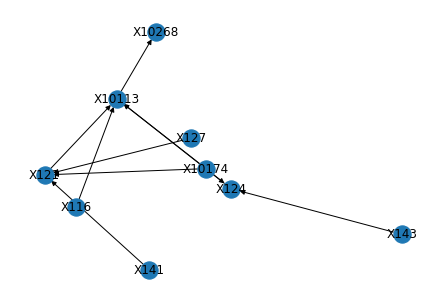

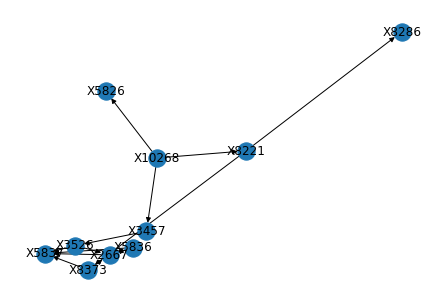

Total node as type (iCom): 4 vs 9
Total node as type (oCom): 7 vs 10


In [ ]:
'''
Create in and on components of the POI. Each component is a graph. 
The components are still between items and not between type/category yet.
'''

iCom_nx, oCom_nx = get_InOuReac(POI, G_Item_nx, True)

print("Total node as type (iCom):",len(collect_type(POI, iCom_nx)), "vs", 
      iCom_nx.number_of_nodes())
print("Total node as type (oCom):",len(collect_type(POI, oCom_nx)), "vs",
      oCom_nx.number_of_nodes())

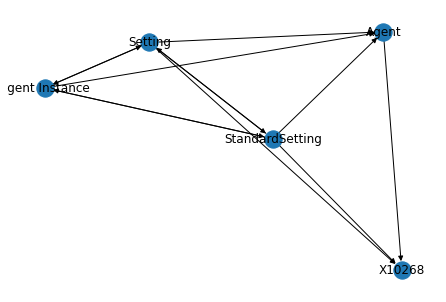

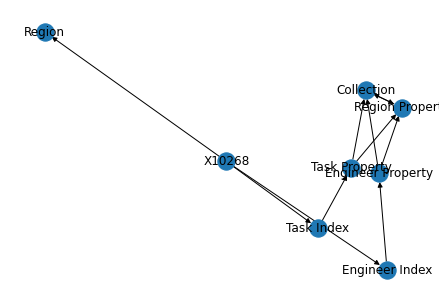

'with open("generated_result/Xoom_dataset_CatFull/d3-"+str(POI)+"-ouCat.json", \'w\') as outfile: \n    json.dump(d3_dataset, outfile)'

In [ ]:
'''
Here, we generate in and out component category(type) graphs.
'''

iComTy_nx = item_to_type(POI, iCom_nx, True)
d3_dataset = create_d3Cat(POI, iComTy_nx)
'''with open("generated_result/Xoom_dataset_CatFull/d3-"+str(POI)+"-inCat.json", 'w') as outfile: 
    json.dump(d3_dataset, outfile)'''

oComTy_nx = item_to_type(POI, oCom_nx, True)
d3_dataset = create_d3Cat(POI, oComTy_nx)
'''with open("generated_result/Xoom_dataset_CatFull/d3-"+str(POI)+"-ouCat.json", 'w') as outfile: 
    json.dump(d3_dataset, outfile)'''

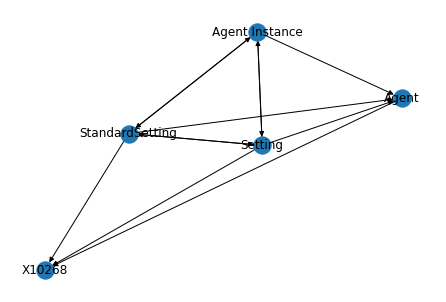

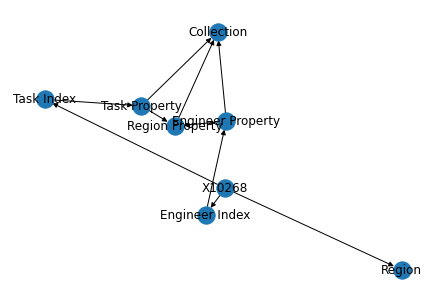

In [ ]:
catOutN = ["Collection","Property","Index"]

iSimpComTy_nx = full_to_simple(iComTy_nx, POI, catOutN, True)
oSimpComTy_nx = full_to_simple(oComTy_nx, POI, catOutN, True)

### The use case with all itemId

In [ ]:
# collect all POI.

POIs = G_Item_nx.nodes()
idX_itemId_html = []
catOutN = ["Collection","Property","Index"] # The categories we cut their outgoing edges.

z=0
for i in POIs:
  #if z<22:
    POI = i
    # -------------------------------------------------------------------------
    iCom_nx, oCom_nx = get_InOuReac(POI, G_Item_nx, False)
    '''print("Total node as type (iCom):",len(collect_type(POI, iCom_nx)), "vs", 
          iCom_nx.number_of_nodes())
    print("Total node as type (oCom):",len(collect_type(POI, oCom_nx)), "vs",
          oCom_nx.number_of_nodes())'''
    
    # -------------------------------------------------------------------------
    iComTy_nx = item_to_type(POI, iCom_nx, False)
    d3_dataset = create_d3Cat(POI, iComTy_nx)
    with open("generated_result/Xoom_dataset_CatFull/d3-"+POI+"-inCat.json", 'w') as outfile: 
        json.dump(d3_dataset, outfile)

    oComTy_nx = item_to_type(POI, oCom_nx, False)
    d3_dataset = create_d3Cat(POI, oComTy_nx)
    with open("generated_result/Xoom_dataset_CatFull/d3-"+POI+"-ouCat.json", 'w') as outfile: 
        json.dump(d3_dataset, outfile)

    # -------------------------------------------------------------------------
    iSimpComTy_nx = full_to_simple(iComTy_nx, POI, catOutN, False)
    d3_dataset = create_d3Cat(POI, iSimpComTy_nx)
    with open("generated_result/Xoom_dataset_CatSimp/d3-"+POI+"-inCat.json", 'w') as outfile: 
        json.dump(d3_dataset, outfile)

    oSimpComTy_nx = full_to_simple(oComTy_nx, POI, catOutN, False)
    d3_dataset = create_d3Cat(POI, oSimpComTy_nx)
    with open("generated_result/Xoom_dataset_CatSimp/d3-"+POI+"-ouCat.json", 'w') as outfile: 
        json.dump(d3_dataset, outfile)
    
    # -------------------------------------------------------------------------
    ItemJs = create_d3Item(POI)
    with open("generated_result/Xoom_dataset_Item/d3-"+POI+".json", 'w') as outfile: 
      json.dump(ItemJs, outfile)
    
    # -------------------------------------------------------------------------
    itemIds = G_Item_nx.nodes[POI]['itemId']
    for i in itemIds:
      ahref_iFull = "<a href='jsonTemp.html?cat="+i+"&JSON=Xoom_dataset_CatFull/d3-"+POI+"-inCat.json' target='_blank'>in "+str(iComTy_nx.number_of_nodes())+"</a>"
      ahref_oFull = "<a href='jsonTemp.html?cat="+i+"&JSON=Xoom_dataset_CatFull/d3-"+POI+"-ouCat.json' target='_blank'>ou "+str(oComTy_nx.number_of_nodes())+"</a>"
      ahref_iSimp = "<a href='jsonTemp.html?cat="+i+"&JSON=Xoom_dataset_CatSimp/d3-"+POI+"-inCat.json' target='_blank'>in "+str(iSimpComTy_nx.number_of_nodes())+"</a>"
      ahref_oSimp = "<a href='jsonTemp.html?cat="+i+"&JSON=Xoom_dataset_CatSimp/d3-"+POI+"-ouCat.json' target='_blank'>ou "+str(oSimpComTy_nx.number_of_nodes())+"</a>" 
      idX_itemId_html.append(
          "<li>"+i+" || Full ("+ahref_iFull+") ("+ahref_oFull+") || Simple ("+ahref_iSimp+") ("+ahref_oSimp+")</li>"
      )

    z+=1
    #print("-"*75)
  

# Generate the index
with open('idX_itemId_html.txt', 'w') as f:
  for item in idX_itemId_html: f.write("%s\n" % item)

'with open(\'idX_itemId_html.txt\', \'w\') as f:\n  for item in idX_itemId_html: f.write("%s\n" % item)'

# Statistics about a graph

In [ ]:
'''The density is 0 for a graph without edges and 1 for a complete graph. The density 
of multigraphs can be higher than 1.
Self loops are counted in the total number of edges so graphs with self loops can 
have density higher than 1.
'''

def detGraph(G_Ref_nx):
  '''with open(os.path.join(os.getcwd(), "generated_result/"+jsonFile)) as f:
      js_graph = json.load(f)
  G_Ref_nx = json_graph.node_link_graph(js_graph)
  print("Details",jsonFile,"graph:")'''
  print("Density of graph:",nx.density(G_Ref_nx))

  #gRef_info = nx.info(G_Ref_nx, n='Rule[Reserve Capacity in Appointment Booking]')
  gRef_info = nx.info(G_Ref_nx, n=None)
  print(gRef_info)
  print("Acyclic:", nx.is_directed_acyclic_graph(G_Ref_nx))
  try:  print(nx.dag_longest_path_length(G_Ref_nx))
  except: pass
  return G_Ref_nx

def count_mulEdge(listEdge):
  count=0
  for i in range(len(listEdge)):
    counterDir = (listEdge[i][1],listEdge[i][0])
    #print(listEdge[i], counterDir)
    if counterDir in listEdge: count+=1
  print("Total multi directed edges:",count)

G_Item_nx = detGraph(G_Item_nx)
count_mulEdge(list(G_Item_nx.edges(data=False)))

Density of graph: 0.00022572481900421626
Name: 
Type: DiGraph
Number of nodes: 10591
Number of edges: 25317
Average in degree:   2.3904
Average out degree:   2.3904
Acyclic: False
Total multi directed edges: 1246


In [ ]:
# Components (Strongly and weak) ----------------------------------------

'''Two vertices are in the same weakly connected component if they are connected by one
or more paths through the network, where paths are allowed to go either way along any edge.

One possibility is that we define A and B to be connected if and only if there 
exists both a directed path from A to B and a directed path from B to A. A and B 
are then said to be strongly connected. We can define components for a directed 
network using this definition of connection and these are called strongly
connected components.
'''

def connected_com(G_Ref_nx):
  # Weekly connected components---------------------------------
  print("Number of weekly components:",nx.number_weakly_connected_components(G_Ref_nx))
  list_compWeak = list(nx.weakly_connected_components(G_Ref_nx))
  dict_compWeak = {}
  for i in range(len(list_compWeak)):
    #print("#node in component", i,":",len(compWeak[i]))
    dict_compWeak.update({i:len(list_compWeak[i])})

  # Strongly connected components---------------------------------
  print("Number of strongly components:",nx.number_strongly_connected_components(G_Ref_nx))

  # Number of components / islands
  tmp_undigraph = G_Ref_nx.to_undirected()
  print("Number of components/islands:",nx.number_connected_components(tmp_undigraph))

connected_com(G_Item_nx); print("-"*50)

Number of weekly components: 5468
Number of strongly components: 10201
Number of components/islands: 5468
--------------------------------------------------


{'X8': 0, 'X23': 0, 'X36': 0, 'X44': 0, 'X47': 0, 'X48': 0, 'X52': 0, 'X53': 0, 'X54': 0, 'X55': 0, 'X56': 0, 'X57': 0, 'X63': 0, 'X64': 0, 'X65': 0, 'X66': 0, 'X67': 0, 'X68': 0, 'X69': 0, 'X70': 0, 'X75': 0, 'X81': 0, 'X86': 0, 'X95': 0, 'X97': 0, 'X101': 0, 'X102': 0, 'X105': 0, 'X106': 0, 'X107': 0, 'X108': 0, 'X109': 0, 'X110': 0, 'X115': 0, 'X169': 0, 'X170': 0, 'X171': 0, 'X173': 0, 'X187': 0, 'X189': 0, 'X190': 0, 'X191': 0, 'X192': 0, 'X193': 0, 'X194': 0, 'X195': 0, 'X196': 0, 'X197': 0, 'X198': 0, 'X199': 0, 'X200': 0, 'X201': 0, 'X202': 0, 'X203': 0, 'X204': 0, 'X205': 0, 'X206': 0, 'X207': 0, 'X208': 0, 'X209': 0, 'X210': 0, 'X211': 0, 'X212': 0, 'X214': 0, 'X215': 0, 'X216': 0, 'X217': 0, 'X218': 0, 'X219': 0, 'X221': 0, 'X222': 0, 'X223': 0, 'X224': 0, 'X225': 0, 'X226': 0, 'X227': 0, 'X228': 0, 'X229': 0, 'X231': 0, 'X232': 0, 'X234': 0, 'X235': 0, 'X237': 0, 'X238': 0, 'X239': 0, 'X240': 0, 'X241': 0, 'X242': 0, 'X243': 0, 'X244': 0, 'X247': 0, 'X250': 0, 'X251': 0, 'X

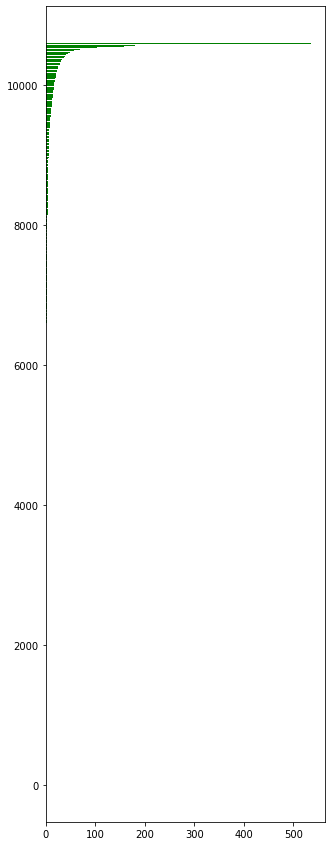

In [ ]:
# Show histogram of node's degree (In and Out)=================================

def distNode(G_Ref_nx):
  gRef_degree = dict(nx.degree(G_Ref_nx))
  gRef_degree = dict(sorted(gRef_degree.items(), key=lambda item: item[1]))
  print(gRef_degree)

  maxD=0; maxN=""
  for key,val in gRef_degree.items():
    if val > maxD: maxD=val; maxN=key
  print("Node with the highest degree:",maxN,maxD) 

  plt.figure(figsize=(5,15))
  #plt.ylim(min(gRef_degree.values()),max(gRef_degree.values()))
  plt.barh(list(range(0, G_Ref_nx.number_of_nodes())), 
          gRef_degree.values(), color='g')
  plt.show()

distNode(G_Item_nx)

Number of components/islands: 5468
#Nodes in a component: [4880, 1, 2, 7, 5, 3, 17, 9, 6, 11, 8, 12, 13]
#Componets: [1, 5415, 1, 4, 35, 5, 1, 1, 1, 1, 1, 1, 1]


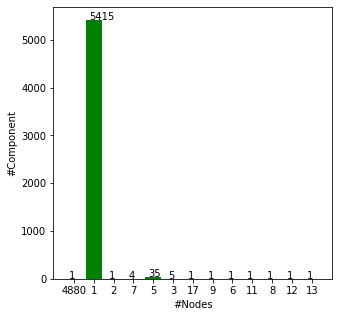

In [ ]:
def distComp(g_nx):
  # Number of components / islands
  # UG1 = g_nx.to_undirected()
  # print("Number of components/islands:",nx.number_connected_components(UG1))
  UG2 = list(nx.weakly_connected_components(g_nx))
  print("Number of components/islands:", len(UG2))

  nInCom0=[]
  for i in range(len(UG2)):
    if len(UG2[i]) not in nInCom0:
      nInCom0.append(len(UG2[i]))
  print("#Nodes in a component:", nInCom0)

  nInCom1=[0]*len(nInCom0)
  for i in range(len(UG2)):
    #print(nInCom0.index(len(UG2[i])), len(UG2[i]))
    nInCom1[nInCom0.index(len(UG2[i]))] = nInCom1[nInCom0.index(len(UG2[i]))]+1
  print("#Componets:", nInCom1)

  nInCom2 = [len(UG2[x]) for x in range(len(UG2))]

  plt.figure(figsize=(5,5))
  plt.bar([str(nInCom0[i]) for i in range(len(nInCom0))], nInCom1, color='g')
  plt.ylabel('#Component')
  plt.xlabel('#Nodes')

  xlocs, xlabs = plt.xticks()
  for i, v in enumerate(nInCom1):
      plt.text(xlocs[i] - 0.25, v + 0.01, str(v))
  plt.show()

distComp(G_Item_nx)

In [ ]:
'''
Find the biggest components in item's graph and have it as a graph.
'''
def get_bigComp(g_nx):
  x = list(nx.weakly_connected_components(g_nx))
  lenSubGraph = [len(i) for i in x]
  #print(max(lenSubGraph), x[lenSubGraph.index(max(lenSubGraph))])
  bigestComp = list(x[lenSubGraph.index(max(lenSubGraph))])
  bigestSG = g_nx.subgraph(bigestComp)
  return bigestSG

G_bC_Item_nx = get_bigComp(G_Item_nx)
print("The biggest component has:", G_bC_Item_nx.number_of_nodes(),
      "nodes and", G_bC_Item_nx.number_of_edges(),"edges")
print("The nodes are:", G_bC_Item_nx.nodes(data=False))

The biggest component has: 4880 nodes and 24927 edges
The nodes are: ['X7864', 'X10087', 'X2336', 'X3477', 'X7979', 'X9680', 'X9742', 'X868', 'X442', 'X7664', 'X9934', 'X573', 'X3007', 'X10585', 'X7082', 'X7513', 'X2512', 'X4334', 'X3317', 'X2866', 'X4957', 'X6651', 'X4581', 'X7521', 'X3290', 'X942', 'X3288', 'X10037', 'X8367', 'X5987', 'X4714', 'X2063', 'X10066', 'X848', 'X7806', 'X2958', 'X7397', 'X4033', 'X8310', 'X2888', 'X4229', 'X8966', 'X2471', 'X2680', 'X4250', 'X9758', 'X2215', 'X428', 'X137', 'X7467', 'X5526', 'X870', 'X5583', 'X3231', 'X7902', 'X3455', 'X7084', 'X9825', 'X8080', 'X2049', 'X4102', 'X5149', 'X4568', 'X5321', 'X2930', 'X506', 'X6087', 'X5748', 'X3035', 'X4891', 'X2573', 'X2218', 'X1017', 'X7529', 'X9328', 'X4198', 'X4793', 'X5528', 'X2712', 'X9063', 'X6904', 'X230', 'X9904', 'X5628', 'X8505', 'X4150', 'X8306', 'X4961', 'X1136', 'X5965', 'X2716', 'X6954', 'X291', 'X10151', 'X8295', 'X7055', 'X88', 'X383', 'X588', 'X3361', 'X7175', 'X7171', 'X9815', 'X5456', 'X58

Density of graph: 0.0010469341675094668
Name: 
Type: DiGraph
Number of nodes: 4880
Number of edges: 24927
Average in degree:   5.1080
Average out degree:   5.1080
Acyclic: False
Total multi directed edges: 1093
Number of weekly components: 1
Number of strongly components: 4541
Number of components/islands: 1
{'X2336': 1, 'X9934': 1, 'X2866': 1, 'X6651': 1, 'X4581': 1, 'X4714': 1, 'X2063': 1, 'X2958': 1, 'X8966': 1, 'X2215': 1, 'X7467': 1, 'X3455': 1, 'X8080': 1, 'X2930': 1, 'X5748': 1, 'X4793': 1, 'X5528': 1, 'X230': 1, 'X9904': 1, 'X291': 1, 'X88': 1, 'X383': 1, 'X9815': 1, 'X5874': 1, 'X6999': 1, 'X4886': 1, 'X9881': 1, 'X7009': 1, 'X2071': 1, 'X9814': 1, 'X836': 1, 'X7090': 1, 'X8517': 1, 'X5292': 1, 'X8109': 1, 'X1079': 1, 'X8564': 1, 'X10378': 1, 'X4851': 1, 'X6934': 1, 'X8201': 1, 'X2882': 1, 'X7671': 1, 'X8444': 1, 'X4889': 1, 'X562': 1, 'X299': 1, 'X3465': 1, 'X5374': 1, 'X3166': 1, 'X8573': 1, 'X7132': 1, 'X3623': 1, 'X1061': 1, 'X7677': 1, 'X5058': 1, 'X5214': 1, 'X8541': 1, 

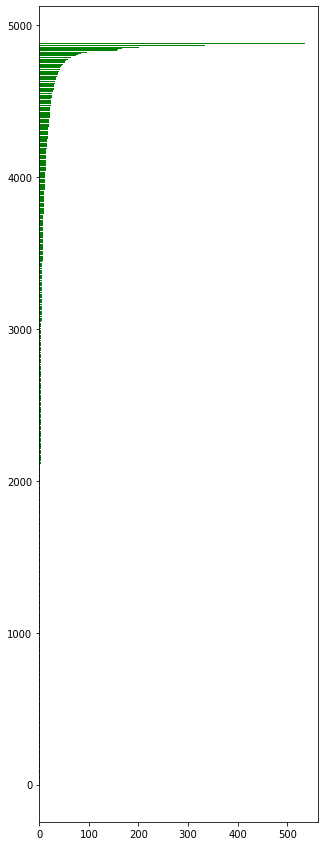

In [ ]:
detGraph(G_bC_Item_nx)
count_mulEdge(list(G_bC_Item_nx.edges(data=False)))
connected_com(G_bC_Item_nx)
distNode(G_bC_Item_nx)

# Community, Partition, Modularity

In [ ]:
import community # Here, community use louvain method
import matplotlib.cm as cm
import itertools, random, json, ast
from networkx.drawing.nx_agraph import write_dot
from networkx.drawing.nx_agraph import to_agraph 
from IPython.display import Image

In [ ]:
def serialize_sets(obj):
  if isinstance(obj, set):
      return list(obj)
  return obj

def dist_cluster(partition, nameFile, showing):
  v = {}
  for key, value in partition.items():
    v.setdefault(value, set()).add(key)
  json_in_str = json.dumps(v, default=serialize_sets)
  with open('generated_result/mod-TEMP.json', 'w') as fp:json.dump(json_in_str, fp)
  with open('generated_result/mod-TEMP.json', 'r') as j:  TEMP_json = json.loads(j.read())
  REAL_json = ast.literal_eval(TEMP_json)
  #for key,val in REAL_json.items():    print(key,len(val))
  with open("generated_result/mod-"+nameFile+".json", 'w') as fp: json.dump(REAL_json, fp)
  
  nodeOfCluster = {}
  for key, value in v.items():
    nodeOfCluster.update({key:len(value)})

  #print(nodeOfCluster)
  if showing:
    plt.figure(figsize=(10,3))
    plt.bar(nodeOfCluster.keys(), nodeOfCluster.values(), color='g')
    plt.ylabel('#Nodes')
    plt.xlabel('#Cluster')
    plt.show()
  return nodeOfCluster

def draw_cluster(G, partition):
  plt.figure(figsize=(10,5))
  pos = nx.spring_layout(G)
  # color the nodes according to their partition
  cmap = cm.get_cmap('viridis', max(partition.values()) + 1)
  nx.draw_networkx_nodes(G, pos, partition.keys(), node_size=40,
                        cmap=cmap, node_color=list(partition.values()))
  nx.draw_networkx_edges(G, pos, alpha=0.5)
  plt.show()

def clustering_G(g_nx, typeCluster, numClus, printing):
  
  if typeCluster=="Louvain":
    partition = community.best_partition(g_nx.to_undirected())
  
  if typeCluster=="GreedyModularity":
    c = list(nx.algorithms.community.greedy_modularity_communities(g_nx.to_undirected()))
    partition={}
    for i in range(len(c)):
      x = sorted(c[i]); #print(x)
      for j in range(len(x)):
        partition.update({x[j]:i})

  if typeCluster=="AsynLpa":
    c = list(nx.algorithms.community.asyn_lpa_communities(g_nx))
    partition={}
    for i in range(len(c)):
      x = sorted(c[i]); #print(x)
      for j in range(len(x)):
        partition.update({x[j]:i})
        
  if typeCluster=="LabelPropagation":
    c = list(nx.algorithms.community.label_propagation_communities(G_bC_OwnerSolo_nx.to_undirected()))
    partition={}
    for i in range(len(c)):
      x = sorted(c[i]); #print(x)
      for j in range(len(x)):
        partition.update({x[j]:i})

      
  if typeCluster=="AsynFluid":
    c = list(nx.algorithms.community.asyn_fluid.asyn_fluidc(G_bC_OwnerSolo_nx.to_undirected(), numClus))
    partition={}
    for i in range(len(c)):
      x = sorted(c[i]); #print(x)
      for j in range(len(x)):
        partition.update({x[j]:i})
    

  if typeCluster=="GirvanNewman":
    comp = list(nx.algorithms.community.centrality.girvan_newman(G_bC_OwnerSolo_nx))
    for communities in itertools.islice(comp, numClus):
      c = tuple(sorted(i) for i in communities)
    partition={}
    for i in range(len(c)):
      x = sorted(c[i]); #print(x)
      for j in range(len(x)):
        partition.update({x[j]:i})

  if printing:  print("Partitions:",partition)
  return partition

def detCluster(g_nx, typeCluster, numClus, nameFile, showing, printing):
  partition = clustering_G(g_nx, typeCluster, numClus, printing)
  nodeOfCluster = dist_cluster(partition, nameFile, showing)
  nodeOfCluster = collections.OrderedDict(sorted(nodeOfCluster.items()))
  if printing: print("NodeOfCluster:",nodeOfCluster)
  if showing: draw_cluster(g_nx, partition)
  nx.set_node_attributes(g_nx, partition, 'hasCluster'+typeCluster)

  # Create a matrix for aggregated louvain's graph
  mtx_AggG = np.zeros((len(nodeOfCluster), len(nodeOfCluster)), 
                                dtype=int)
  tmpE = list(g_nx.edges())
  for i in range(len(tmpE)):
    #if i <4:
      eF = partition[tmpE[i][0]]
      eT = partition[tmpE[i][1]]
      #print(tmpE[i], eF, eT)
      mtx_AggG[eF][eT] = mtx_AggG[eF][eT] + 1

  return mtx_AggG, nodeOfCluster

In [ ]:
def draw_aggregateG(g_nx, nodeOfCluster):
  fig = plt.subplots(figsize=(10,5))
  pos = nx.spring_layout(g_nx, k=50, iterations=20)
  nSiz = list(nodeOfCluster.values()); #nSiz = [10]*g_nx.number_of_nodes()
  #print(nSiz)
  nCol = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             for i in range(g_nx.number_of_nodes())]

  nx.draw(g_nx, pos, with_labels=True, connectionstyle='arc3, rad = 0.1',
          font_size=10, node_size=[nSiz[i]*20 for i in range(len(nSiz))],
          node_color=nCol
          )
  
  edge_labels=dict([((u,v,),d['weight']) for u,v,d in g_nx.edges(data=True)])
  #print(edge_labels)
  nx.draw_networkx_edge_labels(g_nx, pos, edge_labels=edge_labels, label_pos=0.11, 
                              font_size=8)
  plt.show()

def get_aggregateG(mtx, nodeOfCluster, pngPath, showing, printing):
  g_nx = nx.from_numpy_matrix(mtx, create_using=nx.DiGraph)
  if showing: draw_aggregateG(g_nx, nodeOfCluster)

  nx.set_edge_attributes(g_nx, {(e[0], e[1]): {'label': e[2]['weight']} for e in g_nx.edges(data=True)})
  if printing: print("Aggregated G edges:",g_nx.edges(data=True))

  D = nx.drawing.nx_agraph.to_agraph(g_nx)
  D.node_attr.update(color='blue', style='filled', fillcolor='yellow')
  D.edge_attr.update(color='blue', arrowsize=1)
  pos = D.layout('dot'); D.draw('generated_result/'+pngPath)
  
  return D

### Louvain modularity

Partitions: {'X7864': 0, 'X10087': 1, 'X2336': 2, 'X3477': 3, 'X7979': 4, 'X9680': 4, 'X9742': 3, 'X868': 1, 'X442': 3, 'X7664': 5, 'X9934': 6, 'X573': 6, 'X3007': 2, 'X10585': 7, 'X7082': 5, 'X7513': 3, 'X2512': 2, 'X4334': 7, 'X3317': 3, 'X2866': 2, 'X4957': 0, 'X6651': 7, 'X4581': 2, 'X7521': 5, 'X3290': 3, 'X942': 2, 'X3288': 3, 'X10037': 5, 'X8367': 5, 'X5987': 5, 'X4714': 2, 'X2063': 3, 'X10066': 3, 'X848': 1, 'X7806': 8, 'X2958': 0, 'X7397': 4, 'X4033': 1, 'X8310': 1, 'X2888': 7, 'X4229': 5, 'X8966': 2, 'X2471': 4, 'X2680': 4, 'X4250': 1, 'X9758': 3, 'X2215': 3, 'X428': 5, 'X137': 9, 'X7467': 2, 'X5526': 5, 'X870': 1, 'X5583': 10, 'X3231': 3, 'X7902': 3, 'X3455': 5, 'X7084': 5, 'X9825': 11, 'X8080': 1, 'X2049': 3, 'X4102': 3, 'X5149': 7, 'X4568': 1, 'X5321': 12, 'X2930': 7, 'X506': 6, 'X6087': 0, 'X5748': 0, 'X3035': 5, 'X4891': 2, 'X2573': 2, 'X2218': 3, 'X1017': 2, 'X7529': 3, 'X9328': 11, 'X4198': 1, 'X4793': 0, 'X5528': 10, 'X2712': 5, 'X9063': 11, 'X6904': 7, 'X230': 5, 'X9

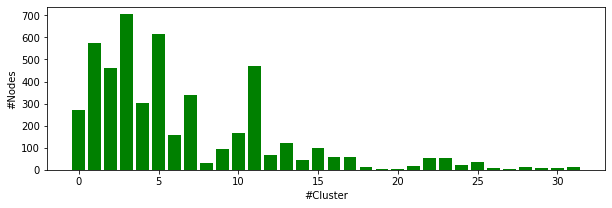

NodeOfCluster: OrderedDict([(0, 270), (1, 573), (2, 463), (3, 704), (4, 303), (5, 617), (6, 157), (7, 339), (8, 30), (9, 94), (10, 169), (11, 472), (12, 65), (13, 120), (14, 44), (15, 98), (16, 60), (17, 58), (18, 13), (19, 4), (20, 2), (21, 15), (22, 52), (23, 54), (24, 21), (25, 35), (26, 7), (27, 2), (28, 13), (29, 7), (30, 7), (31, 12)])


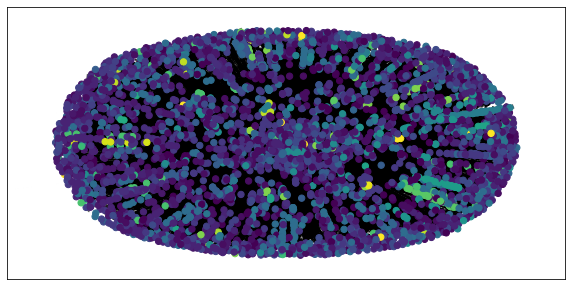

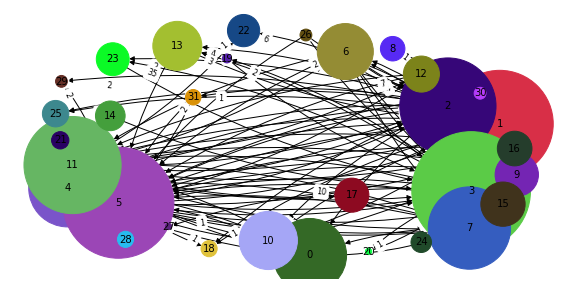

Aggregated G edges: [(0, 0, {'weight': 493, 'label': 493}), (0, 4, {'weight': 12, 'label': 12}), (0, 7, {'weight': 10, 'label': 10}), (0, 11, {'weight': 2, 'label': 2}), (1, 1, {'weight': 2339, 'label': 2339}), (1, 2, {'weight': 54, 'label': 54}), (1, 3, {'weight': 598, 'label': 598}), (1, 4, {'weight': 2, 'label': 2}), (1, 5, {'weight': 297, 'label': 297}), (1, 7, {'weight': 10, 'label': 10}), (1, 8, {'weight': 1, 'label': 1}), (1, 9, {'weight': 2, 'label': 2}), (1, 10, {'weight': 2, 'label': 2}), (1, 11, {'weight': 29, 'label': 29}), (1, 12, {'weight': 2, 'label': 2}), (1, 13, {'weight': 4, 'label': 4}), (1, 15, {'weight': 25, 'label': 25}), (1, 16, {'weight': 12, 'label': 12}), (1, 18, {'weight': 3, 'label': 3}), (1, 23, {'weight': 2, 'label': 2}), (1, 25, {'weight': 2, 'label': 2}), (1, 29, {'weight': 2, 'label': 2}), (2, 0, {'weight': 12, 'label': 12}), (2, 1, {'weight': 31, 'label': 31}), (2, 2, {'weight': 981, 'label': 981}), (2, 3, {'weight': 89, 'label': 89}), (2, 4, {'weight'

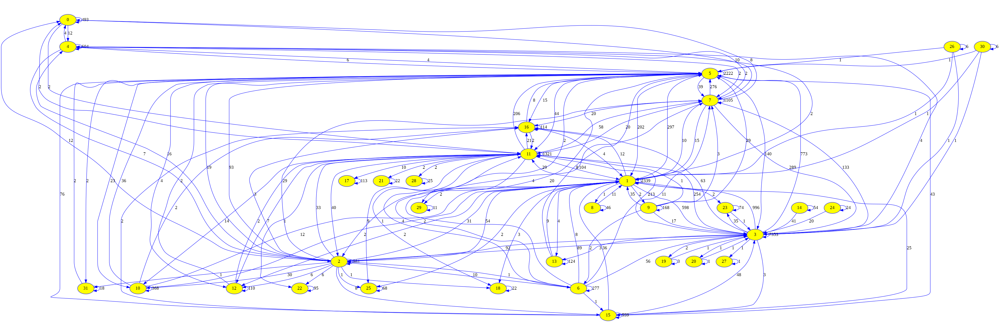

In [ ]:
mtxLou_bC_Item, nodeOfCluster = detCluster(G_bC_Item_nx, "Louvain", 0, "bC_LouItem", True, True)
#print(mtxLou_bC_Item)
G_bCAgg_Item_nx = get_aggregateG(mtxLou_bC_Item, nodeOfCluster, 
                                      "G_bCLou_Item_nx.png", True, True)
Image(G_bCAgg_Item_nx.draw(format='png'))

### Greedy Modularity Communities (Clauset-Newman-Moore)
https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.community.modularity_max.greedy_modularity_communities.html#networkx.algorithms.community.modularity_max.greedy_modularity_communities

Partitions: {'X1000': 0, 'X10110': 0, 'X10111': 0, 'X10112': 0, 'X1014': 0, 'X1017': 0, 'X10181': 0, 'X10182': 0, 'X10199': 0, 'X10229': 0, 'X1035': 0, 'X1036': 0, 'X10365': 0, 'X1037': 0, 'X1041': 0, 'X1042': 0, 'X1043': 0, 'X10451': 0, 'X10518': 0, 'X1052': 0, 'X1053': 0, 'X10542': 0, 'X10545': 0, 'X10558': 0, 'X1056': 0, 'X1057': 0, 'X1077': 0, 'X1078': 0, 'X1079': 0, 'X1080': 0, 'X1081': 0, 'X1082': 0, 'X1083': 0, 'X1084': 0, 'X1085': 0, 'X1086': 0, 'X1087': 0, 'X1088': 0, 'X1089': 0, 'X1091': 0, 'X1099': 0, 'X11': 0, 'X1100': 0, 'X1103': 0, 'X1104': 0, 'X1105': 0, 'X1109': 0, 'X1114': 0, 'X1115': 0, 'X1118': 0, 'X1119': 0, 'X1130': 0, 'X1131': 0, 'X1135': 0, 'X1136': 0, 'X1138': 0, 'X1139': 0, 'X1143': 0, 'X1144': 0, 'X1155': 0, 'X1158': 0, 'X12': 0, 'X166': 0, 'X167': 0, 'X20': 0, 'X2046': 0, 'X2047': 0, 'X2048': 0, 'X2049': 0, 'X2050': 0, 'X2067': 0, 'X2070': 0, 'X2071': 0, 'X2077': 0, 'X2078': 0, 'X2079': 0, 'X2080': 0, 'X2082': 0, 'X2083': 0, 'X2084': 0, 'X2086': 0, 'X2091': 0

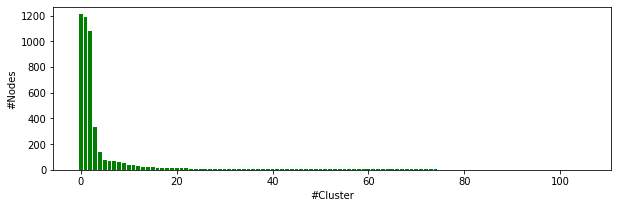

NodeOfCluster: OrderedDict([(0, 1208), (1, 1185), (2, 1079), (3, 335), (4, 139), (5, 76), (6, 67), (7, 65), (8, 58), (9, 52), (10, 39), (11, 35), (12, 30), (13, 20), (14, 20), (15, 19), (16, 16), (17, 15), (18, 13), (19, 13), (20, 13), (21, 12), (22, 11), (23, 10), (24, 10), (25, 10), (26, 9), (27, 8), (28, 8), (29, 8), (30, 8), (31, 7), (32, 7), (33, 7), (34, 7), (35, 7), (36, 7), (37, 7), (38, 7), (39, 7), (40, 6), (41, 6), (42, 6), (43, 6), (44, 6), (45, 6), (46, 6), (47, 5), (48, 5), (49, 5), (50, 5), (51, 5), (52, 5), (53, 5), (54, 5), (55, 5), (56, 5), (57, 5), (58, 5), (59, 5), (60, 5), (61, 5), (62, 5), (63, 5), (64, 5), (65, 4), (66, 4), (67, 3), (68, 3), (69, 3), (70, 3), (71, 3), (72, 3), (73, 3), (74, 3), (75, 2), (76, 2), (77, 2), (78, 2), (79, 2), (80, 2), (81, 2), (82, 2), (83, 2), (84, 2), (85, 2), (86, 2), (87, 2), (88, 2), (89, 2), (90, 2), (91, 2), (92, 2), (93, 2), (94, 2), (95, 2), (96, 2), (97, 2), (98, 2), (99, 2), (100, 2), (101, 2), (102, 2), (103, 2), (104, 2)

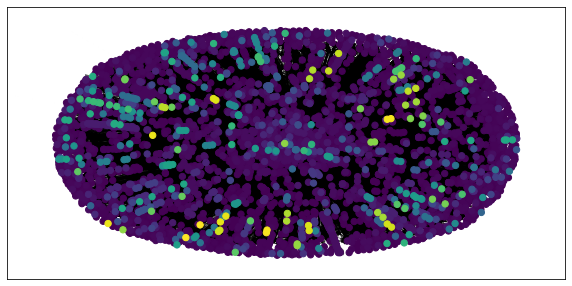

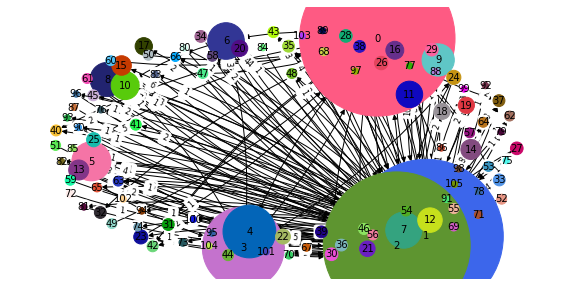

Aggregated G edges: [(0, 0, {'weight': 2519, 'label': 2519}), (0, 1, {'weight': 223, 'label': 223}), (0, 2, {'weight': 119, 'label': 119}), (0, 3, {'weight': 3, 'label': 3}), (0, 6, {'weight': 1, 'label': 1}), (0, 25, {'weight': 5, 'label': 5}), (0, 26, {'weight': 1, 'label': 1}), (0, 30, {'weight': 1, 'label': 1}), (0, 31, {'weight': 1, 'label': 1}), (0, 32, {'weight': 1, 'label': 1}), (0, 37, {'weight': 2, 'label': 2}), (0, 38, {'weight': 1, 'label': 1}), (0, 40, {'weight': 2, 'label': 2}), (0, 42, {'weight': 2, 'label': 2}), (0, 46, {'weight': 2, 'label': 2}), (1, 0, {'weight': 144, 'label': 144}), (1, 1, {'weight': 12392, 'label': 12392}), (1, 2, {'weight': 801, 'label': 801}), (1, 3, {'weight': 113, 'label': 113}), (1, 4, {'weight': 8, 'label': 8}), (1, 5, {'weight': 21, 'label': 21}), (1, 6, {'weight': 44, 'label': 44}), (1, 7, {'weight': 2, 'label': 2}), (1, 8, {'weight': 3, 'label': 3}), (1, 10, {'weight': 13, 'label': 13}), (1, 11, {'weight': 2, 'label': 2}), (1, 12, {'weight'

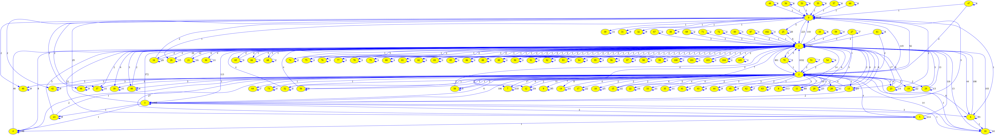

In [ ]:
mtxGre_bC_Item, nodeOfCluster = detCluster(G_bC_Item_nx, "GreedyModularity", 0, "bC_GreItem", True, True)
#print(mtxGre_bC_Item)
G_bCAgg_Item_nx = get_aggregateG(mtxGre_bC_Item, nodeOfCluster, 
                                      "G_bCGre_Item_nx.png", True, True)
Image(G_bCAgg_Item_nx.draw(format='png'))

### asyn_lpa_communities
https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.community.label_propagation.asyn_lpa_communities.html#networkx.algorithms.community.label_propagation.asyn_lpa_communities

Partitions: {'X7857': 0, 'X7864': 0, 'X10087': 1, 'X4037': 1, 'X4039': 1, 'X2336': 2, 'X2340': 2, 'X2514': 2, 'X2992': 3, 'X2995': 3, 'X3372': 3, 'X3447': 3, 'X3477': 3, 'X440': 3, 'X5145': 3, 'X7493': 3, 'X7562': 3, 'X2102': 4, 'X248': 4, 'X2578': 4, 'X2683': 4, 'X3128': 4, 'X3137': 4, 'X317': 4, 'X336': 4, 'X3420': 4, 'X343': 4, 'X345': 4, 'X349': 4, 'X4088': 4, 'X4090': 4, 'X4384': 4, 'X4385': 4, 'X4391': 4, 'X4394': 4, 'X5019': 4, 'X5888': 4, 'X5897': 4, 'X6065': 4, 'X6182': 4, 'X6215': 4, 'X6225': 4, 'X6227': 4, 'X6238': 4, 'X6255': 4, 'X6399': 4, 'X6420': 4, 'X6422': 4, 'X6483': 4, 'X6485': 4, 'X6509': 4, 'X6521': 4, 'X6529': 4, 'X6531': 4, 'X6568': 4, 'X657': 4, 'X6628': 4, 'X6670': 4, 'X6804': 4, 'X6809': 4, 'X6838': 4, 'X6924': 4, 'X6936': 4, 'X6942': 4, 'X6944': 4, 'X7040': 4, 'X7042': 4, 'X7304': 4, 'X7309': 4, 'X7310': 4, 'X7315': 4, 'X7316': 4, 'X7356': 4, 'X7358': 4, 'X7394': 4, 'X7397': 4, 'X7403': 4, 'X7410': 4, 'X7411': 4, 'X7979': 4, 'X8456': 4, 'X8881': 4, 'X8897': 4

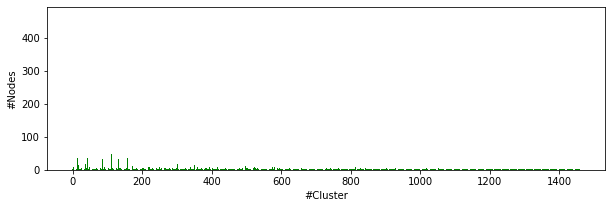

NodeOfCluster: OrderedDict([(0, 2), (1, 3), (2, 3), (3, 9), (4, 91), (5, 3), (6, 11), (7, 1), (8, 1), (9, 11), (10, 2), (11, 1), (12, 5), (13, 471), (14, 35), (15, 1), (16, 3), (17, 16), (18, 1), (19, 6), (20, 2), (21, 2), (22, 4), (23, 1), (24, 7), (25, 1), (26, 5), (27, 8), (28, 2), (29, 5), (30, 4), (31, 1), (32, 30), (33, 101), (34, 1), (35, 2), (36, 5), (37, 19), (38, 8), (39, 3), (40, 6), (41, 10), (42, 2), (43, 35), (44, 3), (45, 1), (46, 1), (47, 1), (48, 1), (49, 9), (50, 121), (51, 14), (52, 1), (53, 18), (54, 7), (55, 1), (56, 8), (57, 1), (58, 3), (59, 1), (60, 1), (61, 4), (62, 3), (63, 2), (64, 2), (65, 6), (66, 3), (67, 6), (68, 13), (69, 5), (70, 3), (71, 6), (72, 1), (73, 3), (74, 3), (75, 3), (76, 79), (77, 3), (78, 57), (79, 3), (80, 4), (81, 9), (82, 2), (83, 1), (84, 1), (85, 21), (86, 32), (87, 2), (88, 3), (89, 1), (90, 3), (91, 1), (92, 9), (93, 1), (94, 4), (95, 1), (96, 67), (97, 2), (98, 58), (99, 4), (100, 7), (101, 5), (102, 2), (103, 4), (104, 1), (105, 10

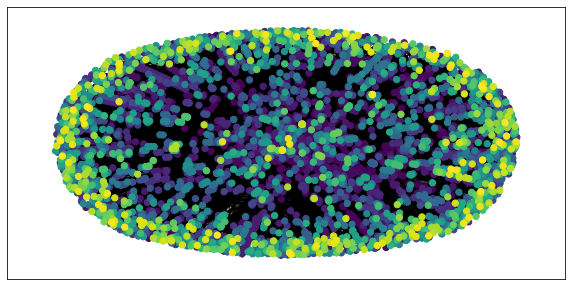

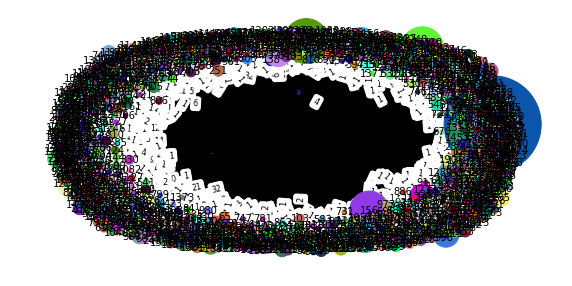

Aggregated G edges: [(0, 0, {'weight': 1, 'label': 1}), (1, 1, {'weight': 2, 'label': 2}), (1, 13, {'weight': 2, 'label': 2}), (1, 148, {'weight': 1, 'label': 1}), (1, 382, {'weight': 1, 'label': 1}), (1, 385, {'weight': 1, 'label': 1}), (1, 1129, {'weight': 1, 'label': 1}), (2, 2, {'weight': 4, 'label': 4}), (2, 37, {'weight': 1, 'label': 1}), (2, 1104, {'weight': 1, 'label': 1}), (3, 3, {'weight': 8, 'label': 8}), (3, 775, {'weight': 6, 'label': 6}), (4, 4, {'weight': 180, 'label': 180}), (4, 13, {'weight': 1, 'label': 1}), (4, 114, {'weight': 2, 'label': 2}), (4, 353, {'weight': 2, 'label': 2}), (4, 417, {'weight': 1, 'label': 1}), (4, 502, {'weight': 2, 'label': 2}), (4, 784, {'weight': 2, 'label': 2}), (4, 1050, {'weight': 1, 'label': 1}), (5, 5, {'weight': 2, 'label': 2}), (5, 1045, {'weight': 1, 'label': 1}), (6, 6, {'weight': 14, 'label': 14}), (9, 9, {'weight': 12, 'label': 12}), (9, 13, {'weight': 1, 'label': 1}), (9, 51, {'weight': 9, 'label': 9}), (9, 78, {'weight': 1, 'lab

/usr/local/lib/python3.7/dist-packages/pygraphviz/agraph.py:1390: RuntimeWarning: neato: graph is too large for cairo-renderer bitmaps. Scaling by 0.278811 to fit

  warnings.warn(b"".join(errors).decode(self.encoding), RuntimeWarning)


In [ ]:
mtxAsy_bC_Item, nodeOfCluster = detCluster(G_bC_Item_nx, "AsynLpa", 0, "bC_AsyItem", True, True)
#print(mtxAsy_bC_Item)
G_bCAgg_Item_nx = get_aggregateG(mtxAsy_bC_Item, nodeOfCluster, 
                                      "G_bCAsy_Item_nx.png", True, True)
Image(G_bCAgg_Item_nx.draw(format='png'))

### label_propagation_communities
https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.community.label_propagation.label_propagation_communities.html#networkx.algorithms.community.label_propagation.label_propagation_communities

In [ ]:
mtxLab_bC_Item, nodeOfCluster = detCluster(G_bC_Item_nx, "LabelPropagation", 0, "bC_LabItem", True, True)
#print(mtxLab_bC_Item)
G_bCAgg_Item_nx = get_aggregateG(mtxLab_bC_Item, nodeOfCluster, 
                                      "G_bCLab_Item_nx.png", True, True)
Image(G_bCAgg_Item_nx.draw(format='png'))

### asyn_fluidc
https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.community.asyn_fluid.asyn_fluidc.html#networkx.algorithms.community.asyn_fluid.asyn_fluidc

In [ ]:
mtxAsyF_bC_Item, nodeOfCluster = detCluster(G_bC_Item_nx, "AsynFluid", 0, "bC_AsyFItem", True, True)
#print(mtxAsyF_bC_Item)
G_bCAgg_Item_nx = get_aggregateG(mtxAsyF_bC_Item, nodeOfCluster, 
                                      "G_bCAsyF_Item_nx.png", True, True)
Image(G_bCAgg_Item_nx.draw(format='png'))

### girvan_newman

In [ ]:
mtxGir_bC_Item, nodeOfCluster = detCluster(G_bC_Item_nx, "GirvanNewman", 0, "bC_GirItem", True, True)
#print(mtxGir_bC_Item)
G_bCAgg_Item_nx = get_aggregateG(mtxGir_bC_Item, nodeOfCluster, 
                                      "G_bCGir_Item_nx.png", True, True)
Image(G_bCAgg_Item_nx.draw(format='png'))

---